In [2]:
import numpy as np
import matplotlib.pyplot as plt
import random

[3.79908201e+000 2.86164880e+000 6.76164599e-001 ... 3.93566442e-135
 5.85088563e-135 1.98749535e-134]


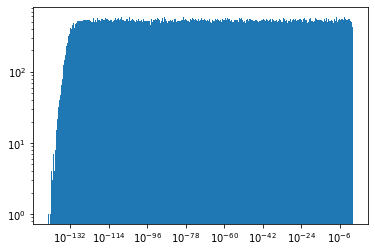

In [2]:
iteration = 500
numSteps = 1000
initMass = 10
masses = np.array([initMass])
fullMass = np.array([])
idx = 0
param = 1

for i in range(iteration):
    for j in range(numSteps):
        split = random.uniform(0,1)
        masses = np.append(masses, masses[idx] * (1-split))
        masses[idx] = masses[idx] * split
        if random.uniform(0,1) < param:
            if split < 0.5:
                idx = len(masses) - 1
        else:
            if split > 0.5:
                idx = len(masses) - 1
    fullMass = np.append(fullMass, masses)
    masses = np.array([initMass])
    idx = 0

print(fullMass)
logbins = np.logspace(np.log10(min(fullMass)), np.log10(1.0), 1000)

plt.hist(fullMass, bins=logbins)
plt.xscale('log')
plt.yscale('log')
plt.show()





/tmp/ipykernel_7017/454694605.py:48: RuntimeWarning: invalid value encountered in log
  alpha = 1 + len(amount[xmin:xmax]) / (np.sum(np.log(amount[xmin:xmax]/ (np.min(amount[xmin:xmax]) - 0.5))))


[nan, nan]

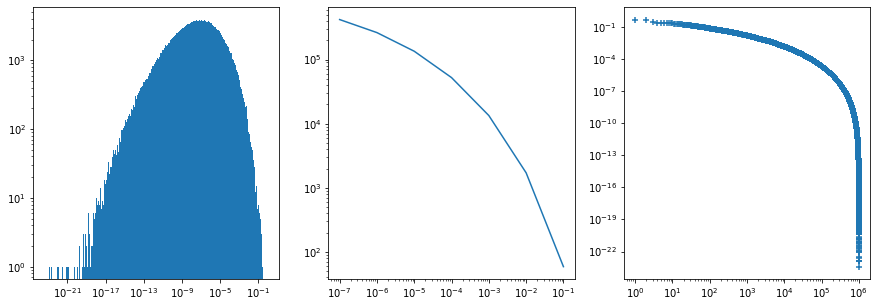

In [44]:
iteration = 10**2
numSteps = 10**4
initMass = 1
masses = np.array([initMass])
fullMass = np.array([])
idx = 0

fig, ax = plt.subplots(1,3,figsize=(15,5))
for i in range(iteration):
    for j in range(numSteps):
        idx = random.randint(0,len(masses)-1)
        split = random.uniform(0,1)
        masses = np.append(masses, masses[idx] * (1-split))
        masses[idx] = masses[idx] * split
    fullMass = np.append(fullMass, masses)
    masses = np.array([initMass])
    idx = 0

logbins = np.logspace(np.log10(min(fullMass)), np.log10(1.0), 1000)
n, bins, patches = ax[0].hist(fullMass, bins=logbins)
ax[0].set_xscale('log')
ax[0].set_yscale('log')
plot_size = int(np.log10(numSteps*1000)) # factor adds OOM to the plots
plot_x = [0]*plot_size
plot_y = [0]*plot_size
plot_count = 0
# print(sum(sim_space)) # check
while plot_count < plot_size:
    plot_power = 1/(10**(plot_count+1))
    plot_x[plot_count] = plot_power
    plot_y[plot_count] = len([i for i in fullMass if i > plot_power]) # https://www.geeksforgeeks.org/python-number-of-values-greater-than-k-in-list/
    plot_count+=1

# plotting log-log
ax[1].set_xscale('log')
ax[1].set_yscale('log')
ax[1].plot(plot_x, plot_y)

ccdf = np.sort(fullMass)[::-1]
ranks = np.arange(1, len(ccdf)+1)

ax[2].scatter(ranks, ccdf, marker='+')
ax[2].set_xscale('log')
ax[2].set_yscale('log')

    
def calc_alpha(amount, xmin, xmax):
    alpha = 1 + len(amount[xmin:xmax]) / (np.sum(np.log(amount[xmin:xmax]/ (np.min(amount[xmin:xmax]) - 0.5))))
    sigma = (alpha - 1) / np.sqrt(len(amount[xmin:xmax]))
    return [alpha, sigma]

/tmp/ipykernel_7017/3363453682.py:38: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  ax[1].scatter(plot_x, plot_y, marker='+')


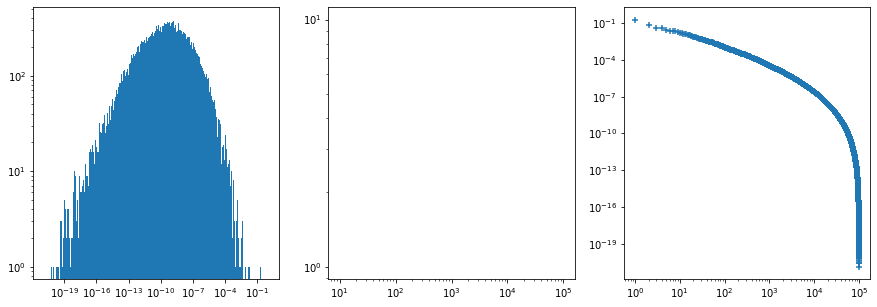

In [12]:
fig, ax = plt.subplots(1,3,figsize=(15,5))
# setup space
sim_size = 10**4
sim_space = [0]*sim_size
sim_count = 0
sim_space[sim_count] = 1
# print(sim_space) # check

# fraction space for one out of simcount+1 elements
while sim_count < sim_size-1:
    rnd_position = random.randint(0,sim_count)
    rnd_fraction = random.random()
    sim_space[sim_count+1]  = sim_space[rnd_position]*(1-rnd_fraction)
    sim_space[rnd_position] = sim_space[rnd_position]*rnd_fraction
    sim_count+=1
    # print(sim_space) # check

# check
ax[0].set_xscale('log')
ax[0].set_yscale('log')
logbins = np.logspace(np.log10(min(sim_space)), np.log10(1.0), 1000)
ax[0].hist(sim_space, bins=logbins)

plot_size = int(np.log10(sim_size*1000)) # factor adds OOM to the plots
plot_x = [0]*plot_size
plot_y = [0]*plot_size
plot_count = 0
# print(sum(sim_space)) # check
while plot_count < plot_size:
    plot_power = 1/(10**(plot_count+1))
    plot_x[plot_count] = plot_power
    plot_y[plot_count] = len([i for i in sim_space if i > plot_power]) # https://www.geeksforgeeks.org/python-number-of-values-greater-than-k-in-list/
    plot_count+=1

# plotting log-log
ax[1].set_xscale('log')
ax[1].set_yscale('log')
ax[1].plot(plot_x, plot_y)
ax[1].scatter(plot_x, plot_y, marker='+')

ccdf = np.sort(sim_space)[::-1]
ranks = np.arange(1, len(ccdf)+1)

ax[2].scatter(ranks, ccdf, marker='+')
ax[2].set_xscale('log')
ax[2].set_yscale('log')
# output for one run:
# [0.1, 0.01, 0.001, 0.0001, 1e-05, 1e-06, 1e-07, 1e-08, 1e-09]
# [1, 13, 129, 831, 4154, 15869, 44950, 101325, 190545]

[1.5974837706856692e-10, 2.7257678008334018e-11, 6.206855548437485e-11, 5.816369762107632e-10, 1.6810586152677522e-10, 5.223308572639964e-11, 9.707003435529558e-10, 1.528787055167311e-10, 1.9282605608917903e-10, 6.405079994279825e-11, 1.2462844501759919e-10, 1.6379397118705799e-10, 2.1001044135902492e-10, 1.8079417668106746e-11, 7.413314813703233e-10, 2.2357493942525544e-09, 8.431252804975412e-12, 6.813700326486351e-11, 1.7950700838840754e-11, 6.287635137174985e-12, 1.8343947493940548e-12, 2.9073160905838375e-11, 1.459914959235638e-10, 3.460541228248148e-11, 3.040517113082172e-12, 2.261117640710555e-12, 3.5088895947921627e-12, 1.0159160657028557e-11, 1.2514291897922694e-10, 2.911877711376012e-10, 7.141372048007408e-12, 1.914470992459428e-11, 1.3810247493792013e-10, 2.2791353875727393e-10, 1.7747573744280728e-11, 1.8494016798955044e-12, 1.487276707005955e-09, 4.3440846882457084e-11, 2.1895056752676635e-10, 2.028339357940013e-10, 2.747183969809373e-11, 7.125021126427932e-11, 1.0187771280

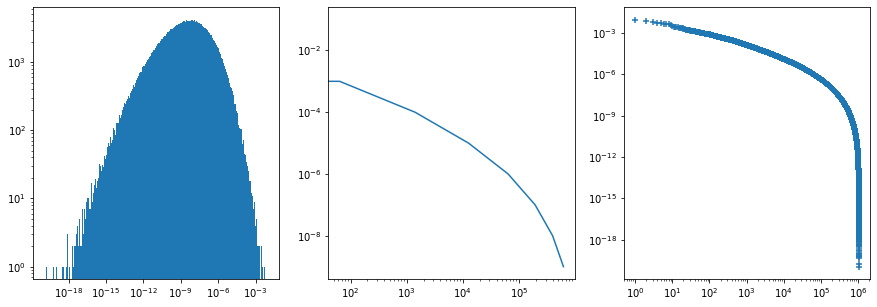

In [18]:
fig, ax = plt.subplots(1,3,figsize=(15,5))
curr_mass = []
next_mass = []
numSteps = 20
initMass = 1
curr_mass.append(initMass)
for i in range(numSteps):
    for j in range(len(curr_mass)):
        split = random.uniform(0,1)
        next_mass.append(curr_mass[j] * (1-split))
        next_mass.append(curr_mass[j] * split)
    curr_mass = next_mass
    next_mass = []   
print(curr_mass)
ax[0].set_xscale('log')
ax[0].set_yscale('log')
logbins = np.logspace(np.log10(min(curr_mass)), np.log10(max(curr_mass)), 1000)
ax[0].hist(curr_mass, bins=logbins)

plot_size = int(np.log10(2**numSteps *1000)) # factor adds OOM to the plots
plot_x = [0]*plot_size
plot_y = [0]*plot_size
plot_count = 0
# print(sum(sim_space)) # check
while plot_count < plot_size:
    plot_power = 1/(10**(plot_count+1))
    plot_x[plot_count] = plot_power
    plot_y[plot_count] = len([i for i in curr_mass if i > plot_power]) # https://www.geeksforgeeks.org/python-number-of-values-greater-than-k-in-list/
    plot_count+=1

# plotting log-log
ax[1].set_xscale('log')
ax[1].set_yscale('log')
ax[1].plot(plot_y, plot_x)

ccdf = np.sort(curr_mass)[::-1]
ranks = np.arange(1, len(ccdf)+1)

ax[2].scatter(ranks, ccdf, marker='+')
ax[2].set_xscale('log')
ax[2].set_yscale('log')


(array([  0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   1.,   0.,   0.,
          0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   1.,   0.,   0.,
          0.,   0.,   0.,   1.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   1.,   1.,   0.,   0.,   1.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   1.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   1.,   1.,   1.,   0.,   0.,   0.,   0.,
          0.,   2.,   2.,   0.,   0., 

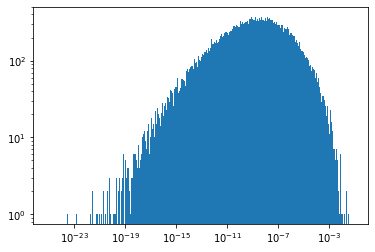

In [39]:
simSpace = []
for i in range(10**5):
    simSpace.append(random.uniform(0,1))
numSteps = 10**6
numIterations = 1
for i in range(numIterations):
    for i in range(numSteps):
        split = random.uniform(0,1)
        int1 = random.randint(0,len(simSpace)-1)
        int2 = random.randint(0,len(simSpace)-1)
        simSpace[int1] = simSpace[int1] * split
        simSpace[int2] = simSpace[int2] * (1-split)

plt.xscale('log')
plt.yscale('log')

logbins = np.logspace(np.log10(min(simSpace)), np.log10(max(simSpace)), 1000)
plt.hist(simSpace, bins=logbins)

